In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt
from typing import Tuple
import torchvision.models as models
import torchvision.transforms as T
import numpy as np
import os

print("Cuda available :", torch.cuda.is_available())
print("cuda version : ", torch.backends.cudnn.version())
print("No of GPU : ", torch.cuda.device_count())
for i in range(torch.cuda.device_count()):
    print(f"Device {i} Name: ", torch.cuda.get_device_name(i))

Cuda available : True
cuda version :  8907
No of GPU :  1
Device 0 Name:  NVIDIA GeForce GTX 1650 with Max-Q Design


In [2]:
# Get image inputs and preprocess
def preprocess_images(image_path1: str, image_path2: str, image_path3: str, image_path4: str, height_width: int = 256) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
    transform = transforms.Compose([
        transforms.Resize((height_width, height_width)),
        transforms.ToTensor()
    ])
    image1 = Image.open(image_path1).convert("RGB")
    image2 = Image.open(image_path2).convert("RGB")
    image3 = Image.open(image_path3).convert("RGB")
    image4 = Image.open(image_path4).convert("RGB")
    # print("Shape of Image 1: ", image1.size)
    image1 = transform(image1)
    image2 = transform(image2)
    image3 = transform(image3)
    image4 = transform(image4)
    # print("Shape of Reshaped Image 1: ", image1.shape)
    return image1, image2, image3, image4

def show_image(image: torch.Tensor) -> None:
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    plt.imshow(image_np)
    plt.axis('off')

# Define a function to display an image on a given axis
def plot_image(ax, image: torch.Tensor, title: str = "", fontsize=8):
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    ax.imshow(image_np)
    ax.set_title(title, fontsize=fontsize)
    ax.axis('off')

In [3]:
def calculate_mean_pixel_difference(image1: torch.Tensor, image2: torch.Tensor, absolute: bool = True) -> float:
    if image1.shape != image2.shape:
        raise ValueError("Error: Tensors must have the same shape.")
    difference = image1 - image2
    if absolute:
        mean_difference = torch.mean(torch.abs(difference))
    else:
        mean_difference = torch.mean(difference ** 2)
    return mean_difference.item()  

In [4]:
### PIXEL WISE Fusing

# Function to combine images pixel-wise with alternating pattern
def combine_images_pixel_wise(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    combined_image_pixel_wise = torch.zeros_like(img1)
    combined_image_pixel_wise[:, 0::2, ::2] = img1[:, 0::2, ::2]    # img1 even rows, even cols
    combined_image_pixel_wise[:, 0::2, 1::2] = img2[:, 0::2, 1::2]  # img2 even rows, odd cols
    combined_image_pixel_wise[:, 1::2, ::2] = img2[:, 1::2, ::2]    # img2 odd rows, even cols
    combined_image_pixel_wise[:, 1::2, 1::2] = img1[:, 1::2, 1::2]  # img1 odd rows, odd cols
    return combined_image_pixel_wise

# Function to reconstruct images from combined image
def reconstruct_images_pixel_wise(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, 0::2, ::2] = combined_image_pixel_wise[:, 0::2, ::2]
    img2_reconstructed_pixel_wise[:, 0::2, 1::2] = combined_image_pixel_wise[:, 0::2, 1::2]
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2]
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2]
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise

In [5]:
# 4NN Refinement
def replace_missing_pixels_with_neighbors(image_tensor: torch.Tensor, secret_image_number: int) -> torch.Tensor:
    channels, height, width = image_tensor.shape
    filled_image = image_tensor.clone()
    for i in range(height):
        for j in range(width):
            if secret_image_number == 1:
                if (i % 2 == 0 and j % 2 == 0) or (i % 2 == 1 and j % 2 == 1):
                    continue  
            elif secret_image_number == 2:
                if (i % 2 == 0 and j % 2 == 1) or (i % 2 == 1 and j % 2 == 0):
                    continue  
            if torch.all(filled_image[:, i, j] == 0):
                neighbors = []
                if i - 1 >= 0 and torch.any(filled_image[:, i - 1, j] != 0):
                    neighbors.append(filled_image[:, i - 1, j])
                if i + 1 < height and torch.any(filled_image[:, i + 1, j] != 0):
                    neighbors.append(filled_image[:, i + 1, j])
                if j - 1 >= 0 and torch.any(filled_image[:, i, j - 1] != 0):
                    neighbors.append(filled_image[:, i, j - 1])
                if j + 1 < width and torch.any(filled_image[:, i, j + 1] != 0):
                    neighbors.append(filled_image[:, i, j + 1])
                if neighbors:
                    filled_image[:, i, j] = torch.mean(torch.stack(neighbors), dim=0)
    return filled_image

In [6]:
### PIXEL WISE WITH MSB TECHNIQUE

# Function to load and preprocess images
def load_image_msb(image_path: str, size=(256, 256)) -> torch.Tensor:
    image = Image.open(image_path).convert("RGB")  
    transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor(),  
    ])
    image_tensor = transform(image) * 255  
    return image_tensor.to(torch.uint8)

# Function to display an image
def plot_image_msb(ax, image: torch.Tensor, title: str):
    image_np = image.permute(1, 2, 0).byte().numpy()  
    ax.imshow(image_np)
    ax.set_title(title)
    ax.axis('off')  

# Combining images using MSB
def combine_images_pixel_wise_msb(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    img1 = img1.to(torch.uint8)
    img2 = img2.to(torch.uint8)
    combined_image_pixel_wise = torch.zeros_like(img1)
    img1_msb = img1 & 0xF0  
    img2_msb = img2 & 0xF0 
    combined_image_pixel_wise[:, ::2, ::2] = (img1_msb[:, ::2, ::2] | (img2_msb[:, ::2, ::2] >> 4))      # even row, even col
    combined_image_pixel_wise[:, ::2, 1::2] = (img2_msb[:, ::2, 1::2] | (img1_msb[:, ::2, 1::2] >> 4))   # even row, odd col
    combined_image_pixel_wise[:, 1::2, ::2] = (img2_msb[:, 1::2, ::2] | (img1_msb[:, 1::2, ::2] >> 4))   # odd row, even col
    combined_image_pixel_wise[:, 1::2, 1::2] = (img1_msb[:, 1::2, 1::2] | (img2_msb[:, 1::2, 1::2] >> 4))# odd row, odd col
    return combined_image_pixel_wise

# Reconstructing images from combined image
def reconstruct_images_pixel_wise_msb(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    combined_image_pixel_wise = combined_image_pixel_wise.to(torch.uint8)
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, ::2, ::2] = combined_image_pixel_wise[:, ::2, ::2] & 0xF0             # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, ::2] = (combined_image_pixel_wise[:, ::2, ::2] & 0x0F) << 4      # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, 1::2] = combined_image_pixel_wise[:, ::2, 1::2] & 0xF0           # even row, odd col
    img1_reconstructed_pixel_wise[:, ::2, 1::2] = (combined_image_pixel_wise[:, ::2, 1::2] & 0x0F) << 4    # even row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2] & 0xF0           # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, ::2] = (combined_image_pixel_wise[:, 1::2, ::2] & 0x0F) << 4    # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2] & 0xF0         # odd row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, 1::2] = (combined_image_pixel_wise[:, 1::2, 1::2] & 0x0F) << 4  # odd row, odd col
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise

In [7]:
#Arnold and Revers Arnold
def arnold_transform_tensor(image_tensor: torch.Tensor, iterations: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  
    transformed_image = image_tensor.clone()
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                x_new = (x + y) % N
                y_new = (x + 2 * y) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image
    return transformed_image

def reverse_arnold_transform_tensor(image_tensor: torch.Tensor, iterations: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  
    transformed_image = image_tensor.clone()
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                x_new = (2 * x - y) % N
                y_new = (-x + y) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image
    return transformed_image

In [10]:
image_path1 = './original_images/fuse1.JPEG'
image_path2 = './original_images/fuse2.JPEG'
image_path3 = './original_images/fuse3.JPEG'
image_path4 = './original_images/fuse4.JPEG'

img1, img2, img3, img4 = preprocess_images(image_path1, image_path2, image_path3, image_path4)

# ENCODE
combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
combined_image_lsb = combine_images_pixel_wise_msb((combined_image_pixel_wise_1*255).to(torch.uint8),(combined_image_pixel_wise_2*255).to(torch.uint8))
scrambled_image = arnold_transform_tensor(combined_image_lsb,8)

# DECODE
descrambled_image = reverse_arnold_transform_tensor(scrambled_image,8)
img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
# img1_reconstructed_pixel_wise = img1_reconstructed_pixel_wise.to(torch.float32) / 255.0
# img2_reconstructed_pixel_wise = img2_reconstructed_pixel_wise.to(torch.float32) / 255.0
img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
# img3_reconstructed_pixel_wise = img3_reconstructed_pixel_wise.to(torch.float32) / 255.0
# img4_reconstructed_pixel_wise = img4_reconstructed_pixel_wise.to(torch.float32) / 255.0
img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)


img1_diff = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
img2_diff = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
img3_diff = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
img4_diff = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)
print(img1_diff)
print(img2_diff)
print(img3_diff)
print(img4_diff)

0.0209595188498497
0.026985151693224907
0.03468157351016998
0.030308229848742485


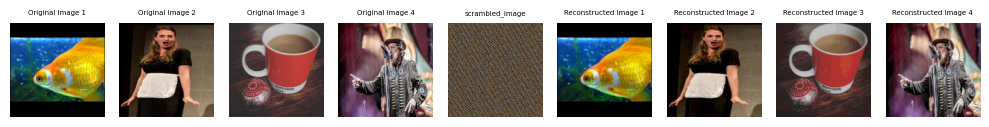

In [76]:
# fig, axes = plt.subplots(2, 4, figsize=(10, 10))
fig, axes = plt.subplots(1, 9, figsize=(10, 10))

plot_image(axes[0], img1, "Original Image 1", fontsize=5)
plot_image(axes[1], img2, "Original Image 2", fontsize=5)
plot_image(axes[2], img4, "Original Image 3", fontsize=5)
plot_image(axes[3], img3, "Original Image 4", fontsize=5)
plot_image(axes[4], scrambled_image, "scrambled_image", fontsize=5)
plot_image(axes[5], img1_NN_refined_pixel_wise, "Reconstructed Image 1", fontsize=5)
plot_image(axes[6], img2_NN_refined_pixel_wise, "Reconstructed Image 2", fontsize=5)
plot_image(axes[7], img4_NN_refined_pixel_wise, "Reconstructed Image 3", fontsize=5)
plot_image(axes[8], img3_NN_refined_pixel_wise, "Reconstructed Image 4", fontsize=5)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

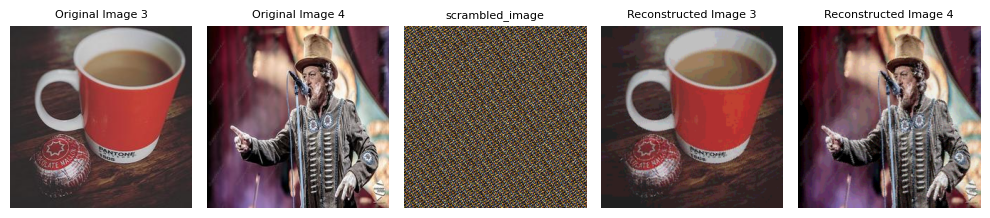

In [ ]:
# fig, axes = plt.subplots(2, 4, figsize=(10, 10))
fig, axes = plt.subplots(1, 5, figsize=(10, 10))

plot_image(axes[0], img4, "Original Image 1")
plot_image(axes[1], img3, "Original Image 2")
plot_image(axes[2], scrambled_image, "scrambled_image")
plot_image(axes[3], img4_NN_refined_pixel_wise, "Reconstructed Image 1")
plot_image(axes[4], img3_NN_refined_pixel_wise, "Reconstructed Image 2")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

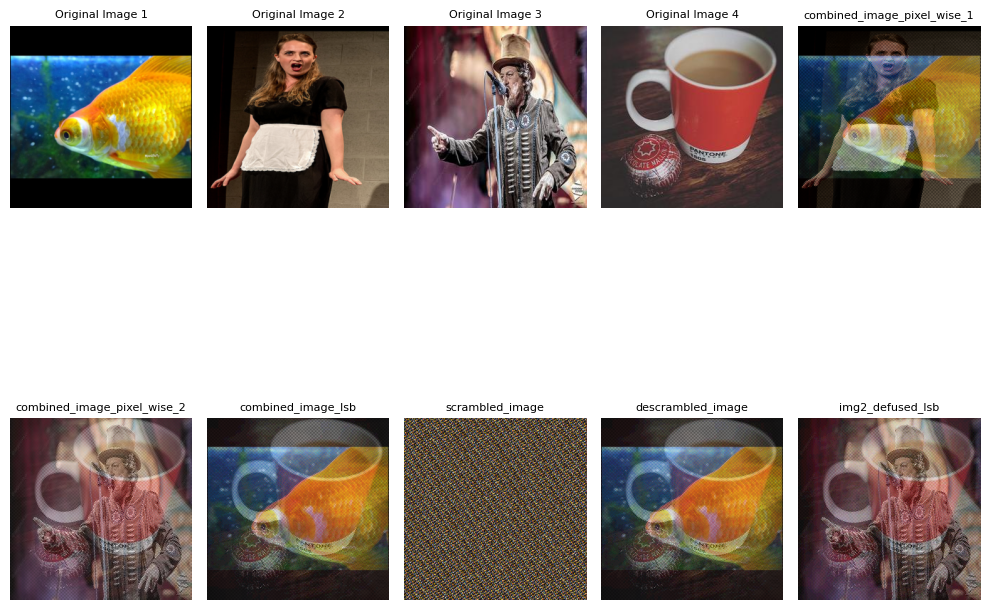

In [69]:
# fig, axes = plt.subplots(2, 4, figsize=(10, 10))
fig, axes = plt.subplots(2, 5, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], img3, "Original Image 3")
plot_image(axes[0][3], img4, "Original Image 4")
plot_image(axes[0][4], combined_image_pixel_wise_1, "combined_image_pixel_wise_1")
plot_image(axes[1][0], combined_image_pixel_wise_2, "combined_image_pixel_wise_2")
plot_image(axes[1][1], combined_image_lsb, "combined_image_lsb")
plot_image(axes[1][2], scrambled_image, "scrambled_image")
plot_image(axes[1][3], descrambled_image, "descrambled_image")
# plot_image(axes[1][3], img1_defused_lsb, "img1_defused_lsb")
plot_image(axes[1][4], img2_defused_lsb, "img2_defused_lsb")
# plot_image(axes[1][2], scrambled_image, "Intermediate Image")
# plot_image(axes[1][2], img1_NN_refined_pixel_wise, "Refined Image 1")
# plot_image(axes[2][0], img2_NN_refined_pixel_wise, "Refined Image 2")
# plot_image(axes[2][1], img3_NN_refined_pixel_wise, "Refined Image 3")
# plot_image(axes[2][2], img4_NN_refined_pixel_wise, "Refined Image 4")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

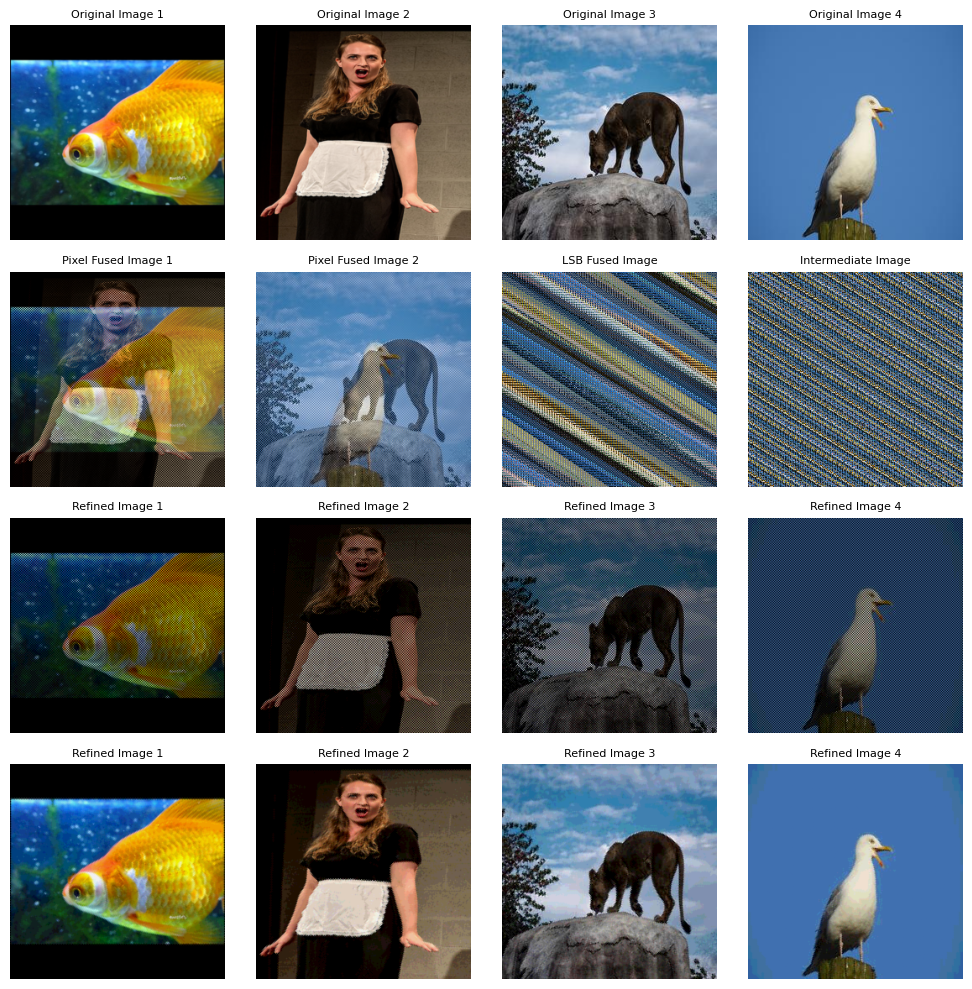

In [67]:
fig, axes = plt.subplots(4, 4, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], img3, "Original Image 3")
plot_image(axes[0][3], img4, "Original Image 4")
plot_image(axes[1][0], combined_image_pixel_wise_1, "Pixel Fused Image 1")
plot_image(axes[1][1], combined_image_pixel_wise_2, "Pixel Fused Image 2")
plot_image(axes[1][2], combined_image_lsb, "LSB Fused Image")
plot_image(axes[1][3], scrambled_image, "Intermediate Image")
# plot_image(axes[1][2], scrambled_image, "Intermediate Image")
plot_image(axes[2][0], img1_reconstructed_pixel_wise, "Refined Image 1")
plot_image(axes[2][1], img2_reconstructed_pixel_wise, "Refined Image 2")
plot_image(axes[2][2], img3_reconstructed_pixel_wise, "Refined Image 3")
plot_image(axes[2][3], img4_reconstructed_pixel_wise, "Refined Image 4")
plot_image(axes[3][0], img1_NN_refined_pixel_wise, "Refined Image 1")
plot_image(axes[3][1], img2_NN_refined_pixel_wise, "Refined Image 2")
plot_image(axes[3][2], img3_NN_refined_pixel_wise, "Refined Image 3")
plot_image(axes[3][3], img4_NN_refined_pixel_wise, "Refined Image 4")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

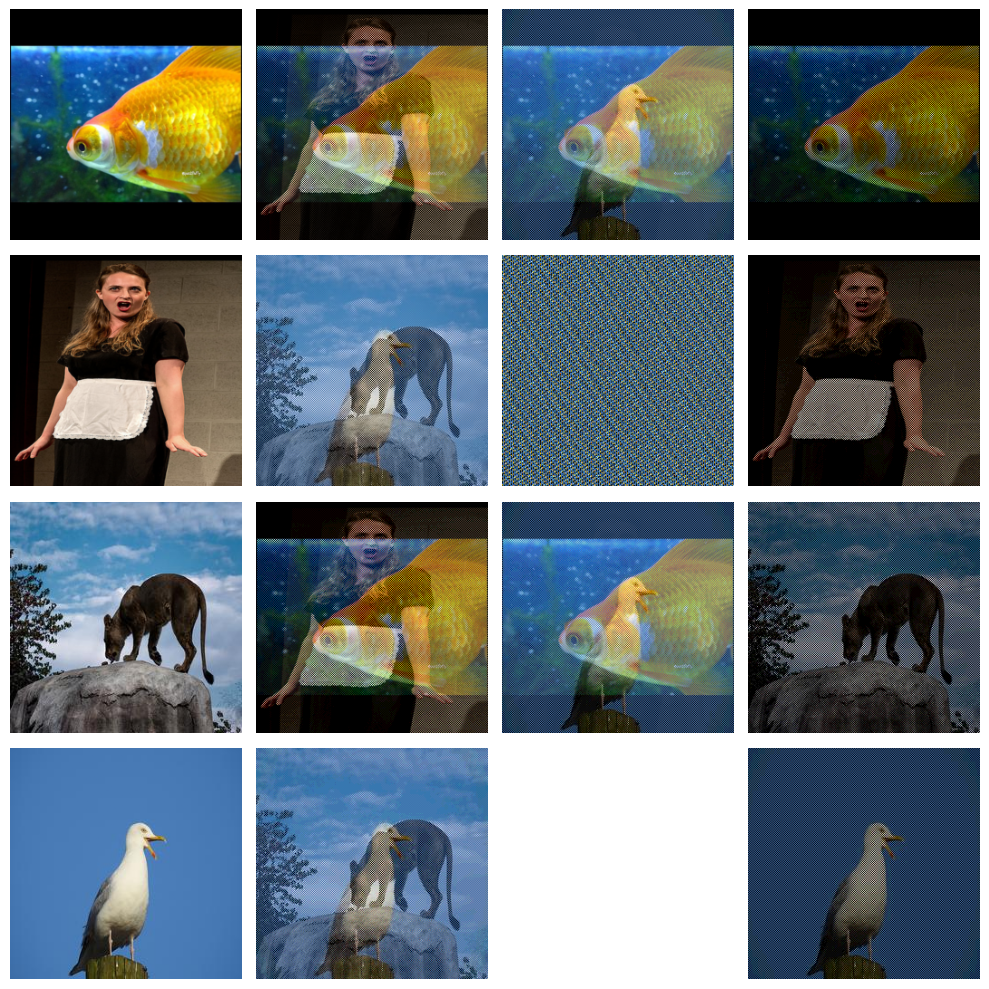

In [55]:
fig, axes = plt.subplots(4, 4, figsize=(10, 10))

plot_image(axes[0][0], img1)
plot_image(axes[1][0], img2)
plot_image(axes[2][0], img3)
plot_image(axes[3][0], img4)

plot_image(axes[0][1], combined_image_pixel_wise_1)
plot_image(axes[1][1], combined_image_pixel_wise_2)
plot_image(axes[2][1], img1_defused_lsb)
plot_image(axes[3][1], img2_defused_lsb)

plot_image(axes[0][2], combined_image_lsb)
plot_image(axes[1][2], scrambled_image)
plot_image(axes[2][2], descrambled_image)
# plot_image(axes[3][2], img4_NN_refined_pixel_wise)

plot_image(axes[0][3], img1_reconstructed_pixel_wise)
plot_image(axes[1][3], img2_reconstructed_pixel_wise)
plot_image(axes[2][3], img3_reconstructed_pixel_wise)
plot_image(axes[3][3], img4_reconstructed_pixel_wise)

# plot_image(axes[0][4], img1_NN_refined_pixel_wise)
# plot_image(axes[1][4], img2_NN_refined_pixel_wise)
# plot_image(axes[2][4], img3_NN_refined_pixel_wise)
# plot_image(axes[3][4], img4_NN_refined_pixel_wise)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

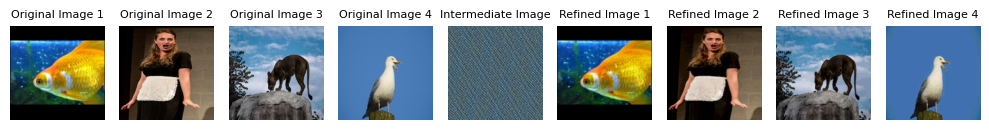

In [56]:
fig, axes = plt.subplots(1, 9, figsize=(10, 10))

plot_image(axes[0], img1, "Original Image 1", fontsize=8)
plot_image(axes[1], img2, "Original Image 2", fontsize=8)
plot_image(axes[2], img3, "Original Image 3", fontsize=8)
plot_image(axes[3], img4, "Original Image 4", fontsize=8)
plot_image(axes[4], scrambled_image, "Intermediate Image", fontsize=8)
plot_image(axes[5], img1_NN_refined_pixel_wise, "Refined Image 1", fontsize=8)
plot_image(axes[6], img2_NN_refined_pixel_wise, "Refined Image 2", fontsize=8)
plot_image(axes[7], img3_NN_refined_pixel_wise, "Refined Image 3", fontsize=8)
plot_image(axes[8], img4_NN_refined_pixel_wise, "Refined Image 4", fontsize=8)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

Image set  0
0.031755007803440094
0.03746761754155159
0.04074425622820854
0.04068763181567192
Image set  1
0.03190532326698303
0.035175442695617676
0.03104572556912899
0.03795500844717026
Image set  2
0.04800873622298241
0.03832908347249031
0.04143894091248512
0.03237256780266762


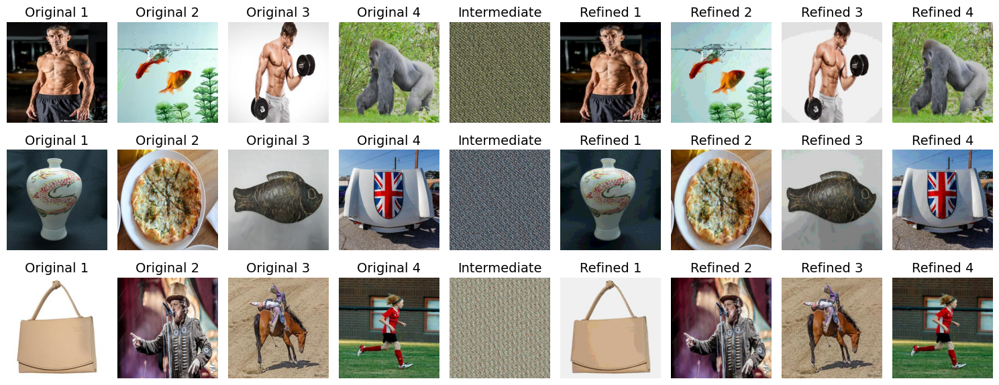

Total Loss : 
0.11166906729340553
0.11097214370965958
0.11322892270982265
0.1110152080655098
Average Loss : 
0.03722302243113518
0.03699071456988653
0.03774297423660755
0.03700506935516993


In [8]:
import torch
import matplotlib.pyplot as plt
import random
import os

# Loss values
img1_loss = 0
img2_loss = 0
img3_loss = 0
img4_loss = 0

# Define the directory where images are stored
image_dir = "./clean_images"
no_of_sets = 3

# Function to randomly select 5 sets of 4 images each
def get_random_image_sets(image_dir, num_sets=no_of_sets, num_images_per_set=4):
    all_images = sorted(os.listdir(image_dir))  # Sort for consistency
    selected_sets = [random.sample(all_images, num_images_per_set) for _ in range(num_sets)]
    return selected_sets

# Get 5 random sets of images
random_image_sets = get_random_image_sets(image_dir)

# Prepare figure for 5 rows (one per set) with 9 columns
fig, axes = plt.subplots(no_of_sets, 9, figsize=(15, 6))

for i, image_set in enumerate(random_image_sets):
    # Load images
    img_paths = [os.path.join(image_dir, img) for img in image_set]
    img1, img2, img3, img4 = preprocess_images(*img_paths)
    
    # Perform pixel-wise combinations
    combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
    
    # Combine with MSB-LSB strategy
    combined_image_lsb = combine_images_pixel_wise_msb(
        (combined_image_pixel_wise_1 * 255).to(torch.uint8), 
        (combined_image_pixel_wise_2 * 255).to(torch.uint8)
    )
    
    # Apply scrambling and descrambling
    scrambled_image = arnold_transform_tensor(combined_image_lsb, 8)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image, 8)
    
    # Defuse images back
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    
    # Reconstruct pixel-wise images
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
    
    # Apply neighbor-based refinement
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)

    # Compute Loss Values
    img1_diff = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
    img2_diff = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
    img3_diff = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
    img4_diff = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)
    img1_loss += img1_diff
    img2_loss += img2_diff
    img3_loss += img3_diff
    img4_loss += img4_diff
    print("Image set ", i)
    print(img1_diff)
    print(img2_diff)
    print(img3_diff)
    print(img4_diff)
    
    # Plot the images for this row
    plot_image(axes[i, 0], img1, "Original 1", fontsize=14)
    plot_image(axes[i, 1], img2, "Original 2", fontsize=14)
    plot_image(axes[i, 2], img3, "Original 3", fontsize=14)
    plot_image(axes[i, 3], img4, "Original 4", fontsize=14)
    plot_image(axes[i, 4], scrambled_image, "Intermediate", fontsize=14)
    plot_image(axes[i, 5], img1_NN_refined_pixel_wise, "Refined 1", fontsize=14)
    plot_image(axes[i, 6], img2_NN_refined_pixel_wise, "Refined 2", fontsize=14)
    plot_image(axes[i, 7], img3_NN_refined_pixel_wise, "Refined 3", fontsize=14)
    plot_image(axes[i, 8], img4_NN_refined_pixel_wise, "Refined 4", fontsize=14)

# Adjust layout and show
plt.tight_layout()
plt.show()

print("Total Loss : ")
print(img1_loss)
print(img2_loss)
print(img3_loss)
print(img4_loss)

print("Average Loss : ")
print(img1_loss/len(random_image_sets))
print(img2_loss/len(random_image_sets))
print(img3_loss/len(random_image_sets))
print(img4_loss/len(random_image_sets))


Image set  0
0.029702233150601387
0.03011106699705124
0.03623558580875397
0.0495336540043354
Image set  1
0.03335067257285118
0.03512129560112953
0.029756074771285057
0.038989707827568054
Image set  2
0.033099327236413956
0.03119056485593319
0.03326011821627617
0.03344951197504997


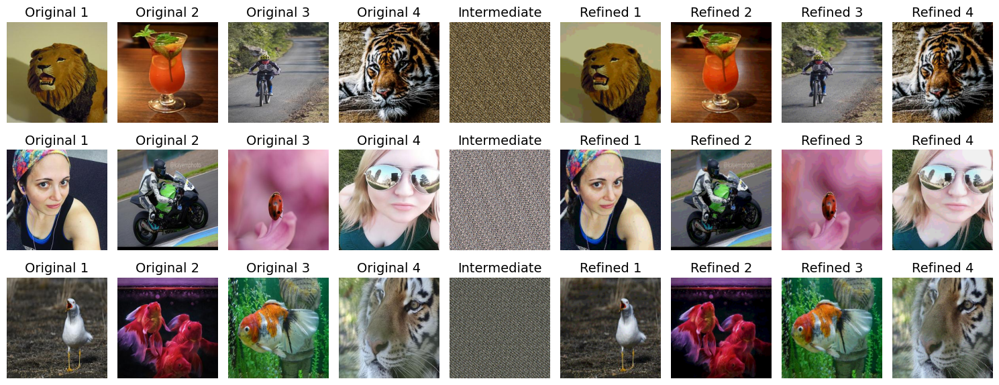

Total Loss : 
0.09615223295986652
0.09642292745411396
0.0992517787963152
0.12197287380695343
Average Loss : 
0.032050744319955506
0.03214097581803799
0.0330839262654384
0.04065762460231781


In [9]:
import torch
import matplotlib.pyplot as plt
import random
import os

# Loss values
img1_loss = 0
img2_loss = 0
img3_loss = 0
img4_loss = 0

# Define the directory where images are stored
image_dir = "./clean_images"
no_of_sets = 3

# Function to randomly select 5 sets of 4 images each
def get_random_image_sets(image_dir, num_sets=no_of_sets, num_images_per_set=4):
    all_images = sorted(os.listdir(image_dir))  # Sort for consistency
    selected_sets = [random.sample(all_images, num_images_per_set) for _ in range(num_sets)]
    return selected_sets

# Get 5 random sets of images
random_image_sets = get_random_image_sets(image_dir)

# Prepare figure for 5 rows (one per set) with 9 columns
fig, axes = plt.subplots(no_of_sets, 9, figsize=(15, 6))

for i, image_set in enumerate(random_image_sets):
    # Load images
    img_paths = [os.path.join(image_dir, img) for img in image_set]
    img1, img2, img3, img4 = preprocess_images(*img_paths)
    
    # Perform pixel-wise combinations
    combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
    
    # Combine with MSB-LSB strategy
    combined_image_lsb = combine_images_pixel_wise_msb(
        (combined_image_pixel_wise_1 * 255).to(torch.uint8), 
        (combined_image_pixel_wise_2 * 255).to(torch.uint8)
    )
    
    # Apply scrambling and descrambling
    scrambled_image = arnold_transform_tensor(combined_image_lsb, 8)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image, 8)
    
    # Defuse images back
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    
    # Reconstruct pixel-wise images
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
    
    # Apply neighbor-based refinement
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)

    # Compute Loss Values
    img1_diff = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
    img2_diff = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
    img3_diff = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
    img4_diff = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)
    img1_loss += img1_diff
    img2_loss += img2_diff
    img3_loss += img3_diff
    img4_loss += img4_diff
    print("Image set ", i)
    print(img1_diff)
    print(img2_diff)
    print(img3_diff)
    print(img4_diff)
    
    # Plot the images for this row
    plot_image(axes[i, 0], img1, "Original 1", fontsize=14)
    plot_image(axes[i, 1], img2, "Original 2", fontsize=14)
    plot_image(axes[i, 2], img3, "Original 3", fontsize=14)
    plot_image(axes[i, 3], img4, "Original 4", fontsize=14)
    plot_image(axes[i, 4], scrambled_image, "Intermediate", fontsize=14)
    plot_image(axes[i, 5], img1_NN_refined_pixel_wise, "Refined 1", fontsize=14)
    plot_image(axes[i, 6], img2_NN_refined_pixel_wise, "Refined 2", fontsize=14)
    plot_image(axes[i, 7], img3_NN_refined_pixel_wise, "Refined 3", fontsize=14)
    plot_image(axes[i, 8], img4_NN_refined_pixel_wise, "Refined 4", fontsize=14)

# Adjust layout and show
plt.tight_layout()
plt.show()

print("Total Loss : ")
print(img1_loss)
print(img2_loss)
print(img3_loss)
print(img4_loss)

print("Average Loss : ")
print(img1_loss/len(random_image_sets))
print(img2_loss/len(random_image_sets))
print(img3_loss/len(random_image_sets))
print(img4_loss/len(random_image_sets))


Image set  0
0.03375634923577309
0.02920549549162388
0.03190762922167778
0.03022942878305912
Image set  1
0.031571462750434875
0.03170904889702797
0.02957715094089508
0.031009143218398094
Image set  2
0.0383923165500164
0.030258862301707268
0.031740229576826096
0.028266310691833496


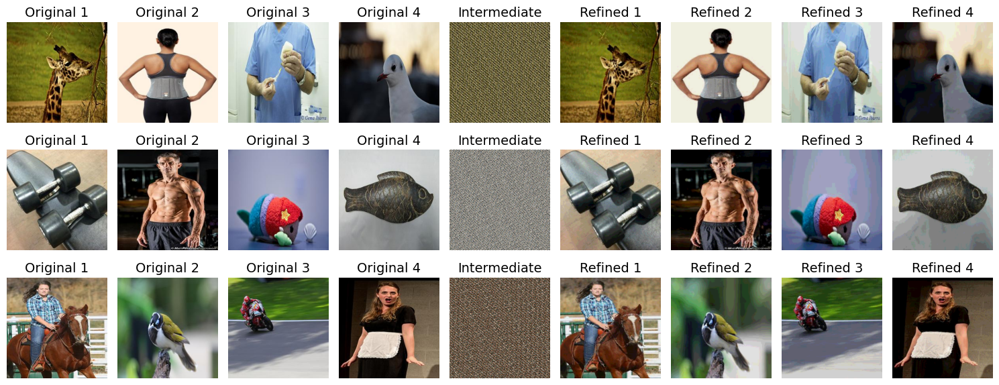

Total Loss : 
0.10372012853622437
0.09117340669035912
0.09322500973939896
0.08950488269329071
Average Loss : 
0.034573376178741455
0.030391135563453037
0.03107500324646632
0.02983496089776357


In [10]:
import torch
import matplotlib.pyplot as plt
import random
import os

# Loss values
img1_loss = 0
img2_loss = 0
img3_loss = 0
img4_loss = 0

# Define the directory where images are stored
image_dir = "./clean_images"
no_of_sets = 3

# Function to randomly select 5 sets of 4 images each
def get_random_image_sets(image_dir, num_sets=no_of_sets, num_images_per_set=4):
    all_images = sorted(os.listdir(image_dir))  # Sort for consistency
    selected_sets = [random.sample(all_images, num_images_per_set) for _ in range(num_sets)]
    return selected_sets

# Get 5 random sets of images
random_image_sets = get_random_image_sets(image_dir)

# Prepare figure for 5 rows (one per set) with 9 columns
fig, axes = plt.subplots(no_of_sets, 9, figsize=(15, 6))

for i, image_set in enumerate(random_image_sets):
    # Load images
    img_paths = [os.path.join(image_dir, img) for img in image_set]
    img1, img2, img3, img4 = preprocess_images(*img_paths)
    
    # Perform pixel-wise combinations
    combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
    
    # Combine with MSB-LSB strategy
    combined_image_lsb = combine_images_pixel_wise_msb(
        (combined_image_pixel_wise_1 * 255).to(torch.uint8), 
        (combined_image_pixel_wise_2 * 255).to(torch.uint8)
    )
    
    # Apply scrambling and descrambling
    scrambled_image = arnold_transform_tensor(combined_image_lsb, 8)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image, 8)
    
    # Defuse images back
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    
    # Reconstruct pixel-wise images
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
    
    # Apply neighbor-based refinement
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)

    # Compute Loss Values
    img1_diff = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
    img2_diff = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
    img3_diff = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
    img4_diff = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)
    img1_loss += img1_diff
    img2_loss += img2_diff
    img3_loss += img3_diff
    img4_loss += img4_diff
    print("Image set ", i)
    print(img1_diff)
    print(img2_diff)
    print(img3_diff)
    print(img4_diff)
    
    # Plot the images for this row
    plot_image(axes[i, 0], img1, "Original 1", fontsize=14)
    plot_image(axes[i, 1], img2, "Original 2", fontsize=14)
    plot_image(axes[i, 2], img3, "Original 3", fontsize=14)
    plot_image(axes[i, 3], img4, "Original 4", fontsize=14)
    plot_image(axes[i, 4], scrambled_image, "Intermediate", fontsize=14)
    plot_image(axes[i, 5], img1_NN_refined_pixel_wise, "Refined 1", fontsize=14)
    plot_image(axes[i, 6], img2_NN_refined_pixel_wise, "Refined 2", fontsize=14)
    plot_image(axes[i, 7], img3_NN_refined_pixel_wise, "Refined 3", fontsize=14)
    plot_image(axes[i, 8], img4_NN_refined_pixel_wise, "Refined 4", fontsize=14)

# Adjust layout and show
plt.tight_layout()
plt.show()

print("Total Loss : ")
print(img1_loss)
print(img2_loss)
print(img3_loss)
print(img4_loss)

print("Average Loss : ")
print(img1_loss/len(random_image_sets))
print(img2_loss/len(random_image_sets))
print(img3_loss/len(random_image_sets))
print(img4_loss/len(random_image_sets))


In [ ]:
import torch
import matplotlib.pyplot as plt
import random
import os

# Loss values
img1_loss = 0
img2_loss = 0
img3_loss = 0
img4_loss = 0

# Define the directory where images are stored
image_dir = "./clean_images"
no_of_sets = 3

# Function to randomly select 5 sets of 4 images each
def get_random_image_sets(image_dir, num_sets=no_of_sets, num_images_per_set=4):
    all_images = sorted(os.listdir(image_dir))  # Sort for consistency
    selected_sets = [random.sample(all_images, num_images_per_set) for _ in range(num_sets)]
    return selected_sets

# Get 5 random sets of images
random_image_sets = get_random_image_sets(image_dir)

# Prepare figure for 5 rows (one per set) with 9 columns
fig, axes = plt.subplots(no_of_sets, 9, figsize=(15, 6))

for i, image_set in enumerate(random_image_sets):
    # Load images
    img_paths = [os.path.join(image_dir, img) for img in image_set]
    img1, img2, img3, img4 = preprocess_images(*img_paths)
    
    # Perform pixel-wise combinations
    combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
    
    # Combine with MSB-LSB strategy
    combined_image_lsb = combine_images_pixel_wise_msb(
        (combined_image_pixel_wise_1 * 255).to(torch.uint8), 
        (combined_image_pixel_wise_2 * 255).to(torch.uint8)
    )
    
    # Apply scrambling and descrambling
    scrambled_image = arnold_transform_tensor(combined_image_lsb, 8)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image, 8)
    
    # Defuse images back
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    
    # Reconstruct pixel-wise images
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
    
    # Apply neighbor-based refinement
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)

    # Compute Loss Values
    img1_diff = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
    img2_diff = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
    img3_diff = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
    img4_diff = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)
    img1_loss += img1_diff
    img2_loss += img2_diff
    img3_loss += img3_diff
    img4_loss += img4_diff
    print("Image set ", i)
    print(img1_diff)
    print(img2_diff)
    print(img3_diff)
    print(img4_diff)
    
    # Plot the images for this row
    plot_image(axes[i, 0], img1, "Original 1", fontsize=14)
    plot_image(axes[i, 1], img2, "Original 2", fontsize=14)
    plot_image(axes[i, 2], img3, "Original 3", fontsize=14)
    plot_image(axes[i, 3], img4, "Original 4", fontsize=14)
    plot_image(axes[i, 4], scrambled_image, "Intermediate", fontsize=14)
    plot_image(axes[i, 5], img1_NN_refined_pixel_wise, "Refined 1", fontsize=14)
    plot_image(axes[i, 6], img2_NN_refined_pixel_wise, "Refined 2", fontsize=14)
    plot_image(axes[i, 7], img3_NN_refined_pixel_wise, "Refined 3", fontsize=14)
    plot_image(axes[i, 8], img4_NN_refined_pixel_wise, "Refined 4", fontsize=14)

# Adjust layout and show
plt.tight_layout()
plt.show()

print("Total Loss : ")
print(img1_loss)
print(img2_loss)
print(img3_loss)
print(img4_loss)

print("Average Loss : ")
print(img1_loss/len(random_image_sets))
print(img2_loss/len(random_image_sets))
print(img3_loss/len(random_image_sets))
print(img4_loss/len(random_image_sets))


Image set  0
0.03319062292575836
0.03594040870666504
0.036894720047712326
0.03638413920998573
Image set  1
0.030139416456222534
0.03372102975845337
0.03346027433872223
0.034684401005506516


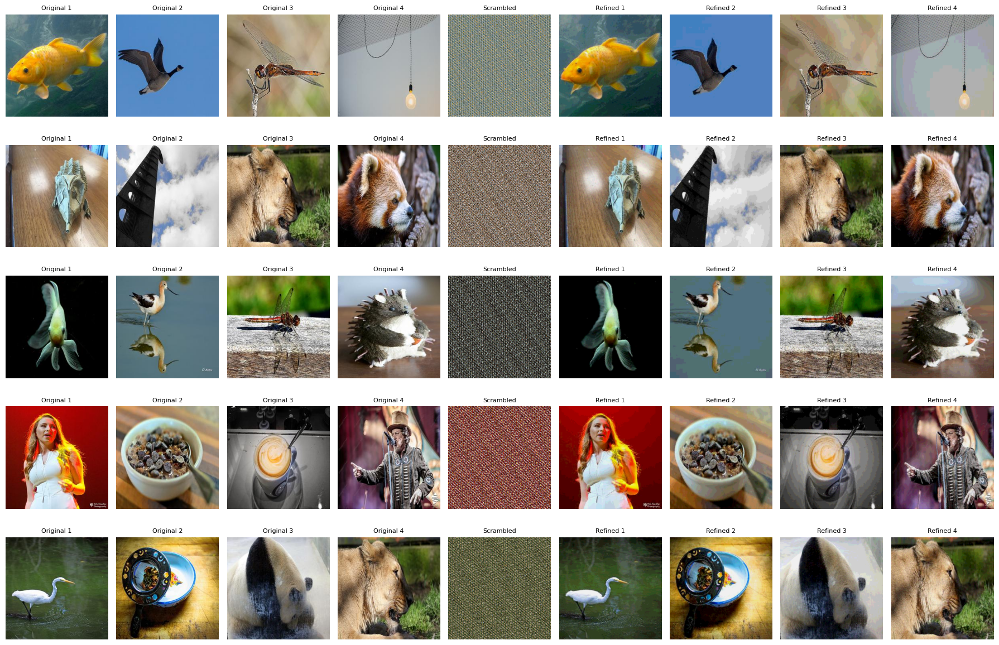


Mean Pixel Difference Table:
        Image 1   Image 2   Image 3   Image 4
Set 1  0.029260  0.029598  0.035624  0.031198
Set 2  0.033752  0.030806  0.035422  0.033620
Set 3  0.009113  0.026884  0.048770  0.033545
Set 4  0.029754  0.032752  0.031238  0.038329
Set 5  0.031419  0.034689  0.030742  0.035413


In [58]:
import os
import torch
import matplotlib.pyplot as plt
import pandas as pd

# List to store the differences
difference_table = []

# Create a figure for multiple image sets
fig, axes = plt.subplots(5, 9, figsize=(18, 12))

for i, image_set in enumerate(random_image_sets):
    # Load images
    img_paths = [os.path.join(image_dir, img) for img in image_set]
    img1, img2, img3, img4 = preprocess_images(*img_paths)
    
    # Perform pixel-wise combinations
    combined_image_pixel_wise_1 = combine_images_pixel_wise(img1, img2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(img3, img4)
    
    # Combine with MSB-LSB strategy
    combined_image_lsb = combine_images_pixel_wise_msb(
        (combined_image_pixel_wise_1 * 255).to(torch.uint8), 
        (combined_image_pixel_wise_2 * 255).to(torch.uint8)
    )
    
    # Apply scrambling and descrambling
    scrambled_image = arnold_transform_tensor(combined_image_lsb, 8)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image, 8)
    
    # Defuse images back
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    
    # Reconstruct pixel-wise images
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img1_defused_lsb)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(img2_defused_lsb)
    
    # Apply neighbor-based refinement
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)
    
    # Calculate differences
    diff1 = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise)
    diff2 = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise)
    diff3 = calculate_mean_pixel_difference(img3, img3_NN_refined_pixel_wise)
    diff4 = calculate_mean_pixel_difference(img4, img4_NN_refined_pixel_wise)

    # Append row data
    difference_table.append([diff1, diff2, diff3, diff4])

    # Plot images in the current row
    plot_image(axes[i, 0], img1, "Original 1")
    plot_image(axes[i, 1], img2, "Original 2")
    plot_image(axes[i, 2], img3, "Original 3")
    plot_image(axes[i, 3], img4, "Original 4")
    plot_image(axes[i, 4], scrambled_image, "Scrambled")
    plot_image(axes[i, 5], img1_NN_refined_pixel_wise, "Refined 1")
    plot_image(axes[i, 6], img2_NN_refined_pixel_wise, "Refined 2")
    plot_image(axes[i, 7], img3_NN_refined_pixel_wise, "Refined 3")
    plot_image(axes[i, 8], img4_NN_refined_pixel_wise, "Refined 4")

# Adjust layout and show the image plot
plt.tight_layout()
plt.show()

# Convert results to DataFrame
df = pd.DataFrame(difference_table, columns=["Image 1", "Image 2", "Image 3", "Image 4"])
df.index = [f"Set {i+1}" for i in range(len(difference_table))]

# Display the table
print("\nMean Pixel Difference Table:")
print(df)


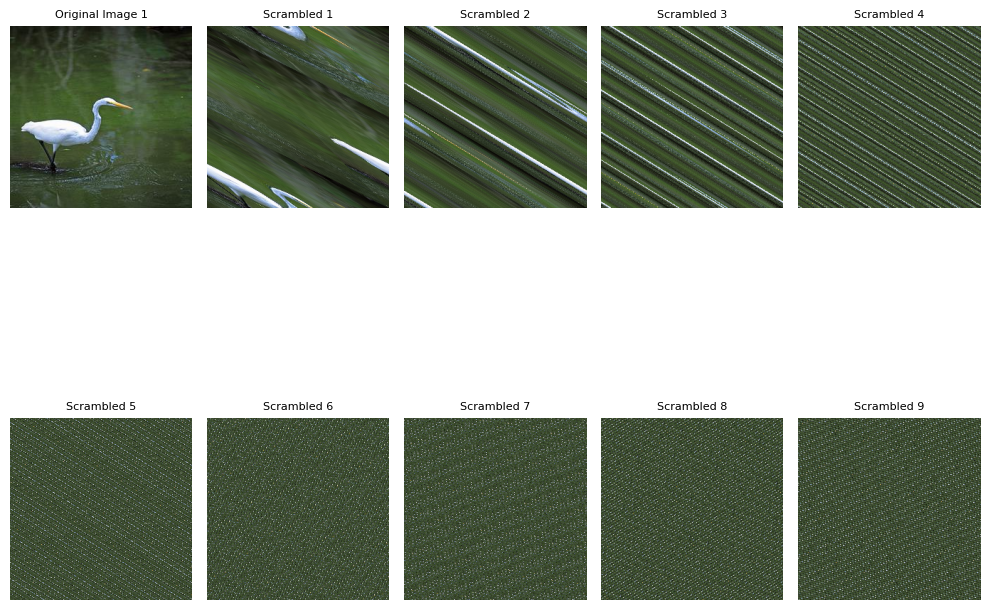

In [59]:
scr_img_1 = arnold_transform_tensor(img1, 1)
scr_img_2 = arnold_transform_tensor(scr_img_1, 1)
scr_img_3 = arnold_transform_tensor(scr_img_2, 1)
scr_img_4 = arnold_transform_tensor(scr_img_3, 1)
scr_img_5 = arnold_transform_tensor(scr_img_4, 1)
scr_img_6 = arnold_transform_tensor(scr_img_5, 1)
scr_img_7 = arnold_transform_tensor(scr_img_6, 1)
scr_img_8 = arnold_transform_tensor(scr_img_7, 1)
scr_img_9 = arnold_transform_tensor(scr_img_8, 1)


fig, axes = plt.subplots(2, 5, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], scr_img_1, "Scrambled 1")
plot_image(axes[0][2], scr_img_2, "Scrambled 2")
plot_image(axes[0][3], scr_img_3, "Scrambled 3")
plot_image(axes[0][4], scr_img_4, "Scrambled 4")
plot_image(axes[1][0], scr_img_5, "Scrambled 5")
plot_image(axes[1][1], scr_img_6, "Scrambled 6")
plot_image(axes[1][2], scr_img_7, "Scrambled 7")
plot_image(axes[1][3], scr_img_8, "Scrambled 8")
plot_image(axes[1][4], scr_img_9, "Scrambled 9")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

In [11]:
def seperate_key(key):
    if len(str(key)) != 7:
        raise ValueError("Key must be a 7-digit integer.")
    key_str = str(key)
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = map(int, key_str)
    return sk1, sk2, sk3, sk4, sk5, sk6, sk7

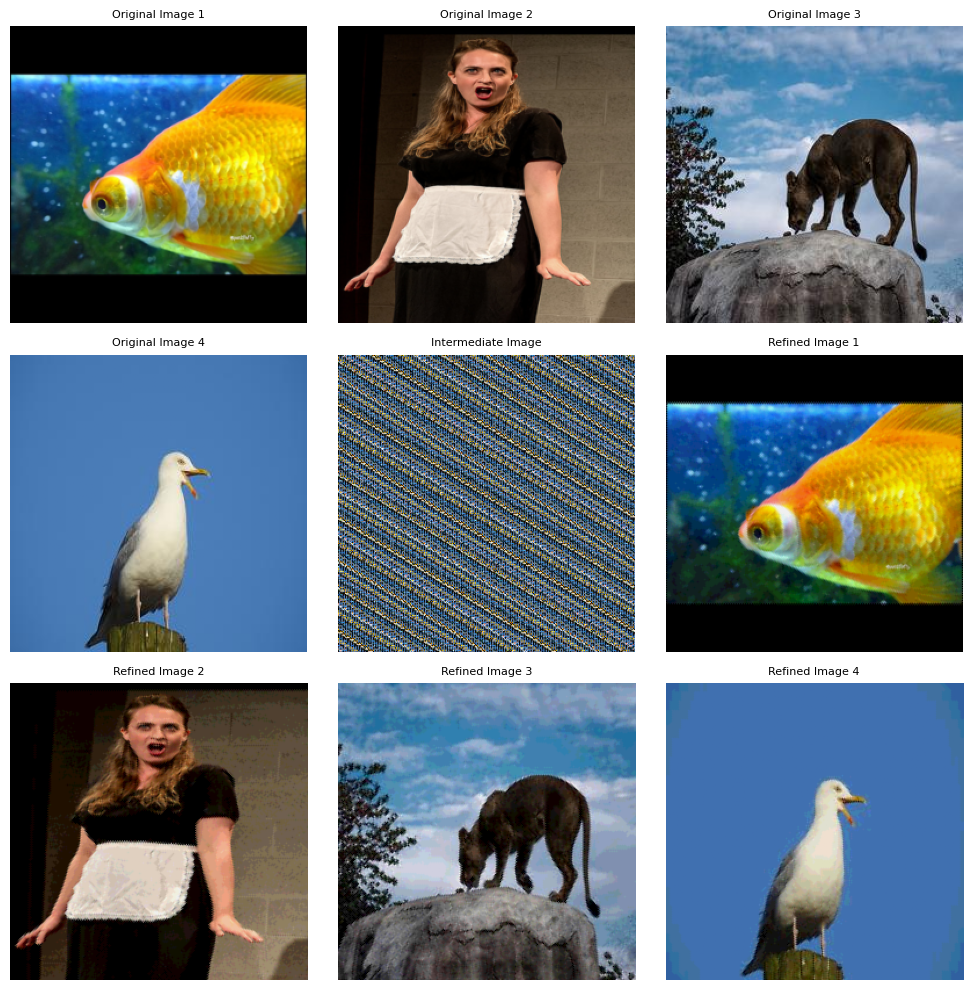

In [12]:
import time
encode_secret_key = '0000222'
decode_secret_key = '0000222'

image_path1 = './original_images/fuse1.JPEG'
image_path2 = './original_images/fuse2.JPEG'
image_path3 = './original_images/fuse3.JPEG'
image_path4 = './original_images/fuse4.JPEG'

img1, img2, img3, img4 = preprocess_images(image_path1, image_path2, image_path3, image_path4)

# ENCODE
def encode_images(img1, img2, img3, img4, encode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(encode_secret_key)
    scr_img_1 = arnold_transform_tensor(img1, sk1)
    scr_img_2 = arnold_transform_tensor(img2, sk2)
    scr_img_3 = arnold_transform_tensor(img3, sk3)
    scr_img_4 = arnold_transform_tensor(img4, sk4)
    combined_image_pixel_wise_1 = combine_images_pixel_wise(scr_img_1, scr_img_2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(scr_img_3, scr_img_4)
    scr_combined_image_pixel_wise_1 = arnold_transform_tensor(combined_image_pixel_wise_1, sk5)
    scr_combined_image_pixel_wise_2 = arnold_transform_tensor(combined_image_pixel_wise_2, sk6)
    combined_image_lsb = combine_images_pixel_wise_msb((scr_combined_image_pixel_wise_1*255).to(torch.uint8),(scr_combined_image_pixel_wise_2*255).to(torch.uint8))
    scrambled_image = arnold_transform_tensor(combined_image_lsb,sk7)
    return scrambled_image

# DECODE
def decode_images(scrambled_image, decode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(decode_secret_key)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image,sk7)
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    des_img1_defused_lsb = reverse_arnold_transform_tensor(img1_defused_lsb,sk5)
    des_img2_defused_lsb = reverse_arnold_transform_tensor(img2_defused_lsb,sk6)
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img1_defused_lsb)
    # img1_reconstructed_pixel_wise = img1_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img2_reconstructed_pixel_wise = img2_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    des_img1_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img1_NN_refined_pixel_wise,sk1)
    des_img2_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img2_NN_refined_pixel_wise,sk2)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img2_defused_lsb)
    # img3_reconstructed_pixel_wise = img3_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img4_reconstructed_pixel_wise = img4_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)
    des_img3_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img3_NN_refined_pixel_wise,sk3)
    des_img4_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img4_NN_refined_pixel_wise,sk4)
    return des_img1_reconstructed_pixel_wise, des_img2_reconstructed_pixel_wise, des_img3_reconstructed_pixel_wise, des_img4_reconstructed_pixel_wise 


scrambled_image = encode_images(img1, img2, img3, img4, encode_secret_key)
rec1, rec2, rec3, rec4 = decode_images(scrambled_image, decode_secret_key)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], img3, "Original Image 3")
plot_image(axes[1][0], img4, "Original Image 4")
plot_image(axes[1][1], scrambled_image, "Intermediate Image")
# plot_image(axes[1][2], scrambled_image, "Intermediate Image")
plot_image(axes[1][2], rec1, "Refined Image 1")
plot_image(axes[2][0], rec2, "Refined Image 2")
plot_image(axes[2][1], rec3, "Refined Image 3")
plot_image(axes[2][2], rec4, "Refined Image 4")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

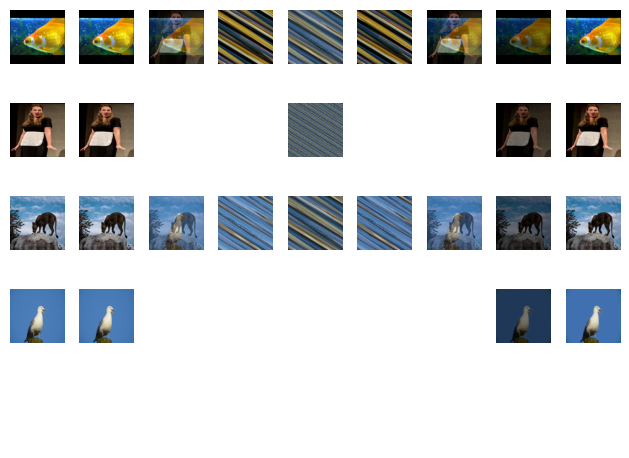

In [24]:
import time
encode_secret_key = '0000222'
decode_secret_key = '0000222'

image_path1 = './original_images/fuse1.JPEG'
image_path2 = './original_images/fuse2.JPEG'
image_path3 = './original_images/fuse3.JPEG'
image_path4 = './original_images/fuse4.JPEG'

img1, img2, img3, img4 = preprocess_images(image_path1, image_path2, image_path3, image_path4)

# ENCODE
def encode_images(img1, img2, img3, img4, encode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(encode_secret_key)
    scr_img_1 = arnold_transform_tensor(img1, sk1)
    scr_img_2 = arnold_transform_tensor(img2, sk2)
    scr_img_3 = arnold_transform_tensor(img3, sk3)
    scr_img_4 = arnold_transform_tensor(img4, sk4)
    combined_image_pixel_wise_1 = combine_images_pixel_wise(scr_img_1, scr_img_2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(scr_img_3, scr_img_4)
    scr_combined_image_pixel_wise_1 = arnold_transform_tensor(combined_image_pixel_wise_1, sk5)
    scr_combined_image_pixel_wise_2 = arnold_transform_tensor(combined_image_pixel_wise_2, sk6)
    combined_image_lsb = combine_images_pixel_wise_msb((scr_combined_image_pixel_wise_1*255).to(torch.uint8),(scr_combined_image_pixel_wise_2*255).to(torch.uint8))
    scrambled_image = arnold_transform_tensor(combined_image_lsb,sk7)
    return scr_img_1, scr_img_2, scr_img_3, scr_img_4, combined_image_pixel_wise_1, combined_image_pixel_wise_2, scr_combined_image_pixel_wise_1, scr_combined_image_pixel_wise_2, combined_image_lsb, scrambled_image

# DECODE
def decode_images(scrambled_image, decode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(decode_secret_key)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image,sk7)
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    des_img1_defused_lsb = reverse_arnold_transform_tensor(img1_defused_lsb,sk5)
    des_img2_defused_lsb = reverse_arnold_transform_tensor(img2_defused_lsb,sk6)
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img1_defused_lsb)
    # img1_reconstructed_pixel_wise = img1_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img2_reconstructed_pixel_wise = img2_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    des_img1_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img1_NN_refined_pixel_wise,sk1)
    des_img2_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img2_NN_refined_pixel_wise,sk2)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img2_defused_lsb)
    # img3_reconstructed_pixel_wise = img3_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img4_reconstructed_pixel_wise = img4_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)
    des_img3_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img3_NN_refined_pixel_wise,sk3)
    des_img4_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img4_NN_refined_pixel_wise,sk4)
    return descrambled_image, img1_defused_lsb, img2_defused_lsb, des_img1_defused_lsb, des_img2_defused_lsb, img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise, img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise, img1_NN_refined_pixel_wise, img2_NN_refined_pixel_wise, img3_NN_refined_pixel_wise, img4_NN_refined_pixel_wise, des_img1_reconstructed_pixel_wise, des_img2_reconstructed_pixel_wise, des_img3_reconstructed_pixel_wise, des_img4_reconstructed_pixel_wise


scr_img_1, scr_img_2, scr_img_3, scr_img_4, combined_image_pixel_wise_1, combined_image_pixel_wise_2, scr_combined_image_pixel_wise_1, scr_combined_image_pixel_wise_2, combined_image_lsb, scrambled_image = encode_images(img1, img2, img3, img4, encode_secret_key)
descrambled_image, img1_defused_lsb, img2_defused_lsb, des_img1_defused_lsb, des_img2_defused_lsb, img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise, img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise, img1_NN_refined_pixel_wise, img2_NN_refined_pixel_wise, img3_NN_refined_pixel_wise, img4_NN_refined_pixel_wise, des_img1_reconstructed_pixel_wise, des_img2_reconstructed_pixel_wise, des_img3_reconstructed_pixel_wise, des_img4_reconstructed_pixel_wise = decode_images(scrambled_image, decode_secret_key)

fig, axes = plt.subplots(5, 9)

plot_image(axes[0][0], img1)
plot_image(axes[1][0], img2)
plot_image(axes[2][0], img3)
plot_image(axes[3][0], img4)

plot_image(axes[0][1], scr_img_1)
plot_image(axes[1][1], scr_img_2)
plot_image(axes[2][1], scr_img_3)
plot_image(axes[3][1], scr_img_4)

plot_image(axes[0][2], combined_image_pixel_wise_1)
plot_image(axes[2][2], combined_image_pixel_wise_2)

plot_image(axes[0][3], scr_combined_image_pixel_wise_1)
plot_image(axes[2][3], scr_combined_image_pixel_wise_2)

plot_image(axes[0][4], combined_image_lsb)
plot_image(axes[1][4], scrambled_image)

plot_image(axes[2][4], descrambled_image)
# plot_image(axes[3][3], img4_NN_refined_pixel_wise)

plot_image(axes[0][5], img1_defused_lsb)
plot_image(axes[2][5], img2_defused_lsb)

plot_image(axes[0][6], des_img1_defused_lsb)
plot_image(axes[2][6], des_img2_defused_lsb)

plot_image(axes[0][7], img1_reconstructed_pixel_wise)
plot_image(axes[1][7], img2_reconstructed_pixel_wise)
plot_image(axes[2][7], img3_reconstructed_pixel_wise)
plot_image(axes[3][7], img4_reconstructed_pixel_wise)

plot_image(axes[0][8], img1_NN_refined_pixel_wise)
plot_image(axes[1][8], img2_NN_refined_pixel_wise)
plot_image(axes[2][8], img3_NN_refined_pixel_wise)
plot_image(axes[3][8], img4_NN_refined_pixel_wise)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

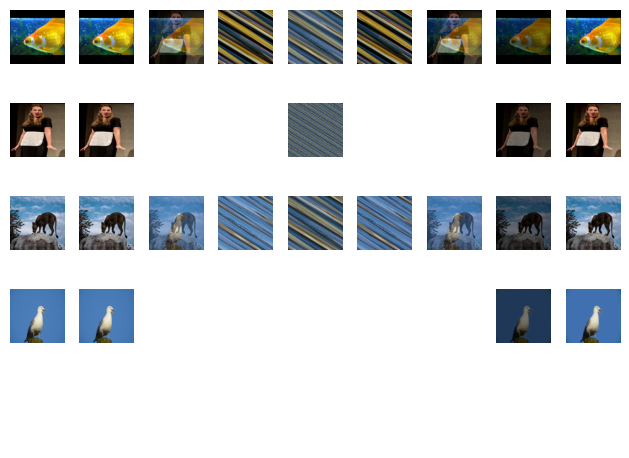

In [21]:
fig, axes = plt.subplots(5, 9)

plot_image(axes[0][0], img1)
plot_image(axes[1][0], img2)
plot_image(axes[2][0], img3)
plot_image(axes[3][0], img4)

plot_image(axes[0][1], scr_img_1)
plot_image(axes[1][1], scr_img_2)
plot_image(axes[2][1], scr_img_3)
plot_image(axes[3][1], scr_img_4)

plot_image(axes[0][2], combined_image_pixel_wise_1)
plot_image(axes[2][2], combined_image_pixel_wise_2)

plot_image(axes[0][3], scr_combined_image_pixel_wise_1)
plot_image(axes[2][3], scr_combined_image_pixel_wise_2)

plot_image(axes[0][4], combined_image_lsb)
plot_image(axes[1][4], scrambled_image)

plot_image(axes[2][4], descrambled_image)
# plot_image(axes[3][3], img4_NN_refined_pixel_wise)

plot_image(axes[0][5], img1_defused_lsb)
plot_image(axes[2][5], img2_defused_lsb)

plot_image(axes[0][6], des_img1_defused_lsb)
plot_image(axes[2][6], des_img2_defused_lsb)

plot_image(axes[0][7], img1_reconstructed_pixel_wise)
plot_image(axes[1][7], img2_reconstructed_pixel_wise)
plot_image(axes[2][7], img3_reconstructed_pixel_wise)
plot_image(axes[3][7], img4_reconstructed_pixel_wise)

plot_image(axes[0][8], img1_NN_refined_pixel_wise)
plot_image(axes[1][8], img2_NN_refined_pixel_wise)
plot_image(axes[2][8], img3_NN_refined_pixel_wise)
plot_image(axes[3][8], img4_NN_refined_pixel_wise)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

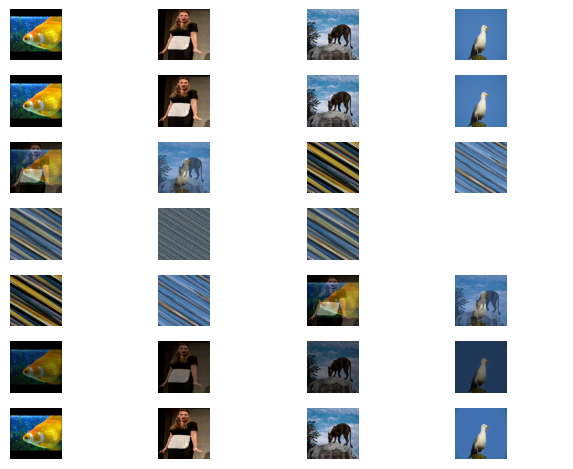

In [65]:
fig, axes = plt.subplots(7, 4)

plot_image(axes[0][0], img1)
plot_image(axes[0][1], img2)
plot_image(axes[0][2], img3)
plot_image(axes[0][3], img4)

plot_image(axes[1][0], scr_img_1)
plot_image(axes[1][1], scr_img_2)
plot_image(axes[1][2], scr_img_3)
plot_image(axes[1][3], scr_img_4)

plot_image(axes[2][0], combined_image_pixel_wise_1)
plot_image(axes[2][1], combined_image_pixel_wise_2)
plot_image(axes[2][2], scr_combined_image_pixel_wise_1)
plot_image(axes[2][3], scr_combined_image_pixel_wise_2)

plot_image(axes[3][0], combined_image_lsb)
plot_image(axes[3][1], scrambled_image)

plot_image(axes[3][2], descrambled_image)
# plot_image(axes[3][3], img4_NN_refined_pixel_wise)

plot_image(axes[4][0], img1_defused_lsb)
plot_image(axes[4][1], img2_defused_lsb)
plot_image(axes[4][2], des_img1_defused_lsb)
plot_image(axes[4][3], des_img2_defused_lsb)

plot_image(axes[5][0], img1_reconstructed_pixel_wise)
plot_image(axes[5][1], img2_reconstructed_pixel_wise)
plot_image(axes[5][2], img3_reconstructed_pixel_wise)
plot_image(axes[5][3], img4_reconstructed_pixel_wise)

plot_image(axes[6][0], img1_NN_refined_pixel_wise)
plot_image(axes[6][1], img2_NN_refined_pixel_wise)
plot_image(axes[6][2], img3_NN_refined_pixel_wise)
plot_image(axes[6][3], img4_NN_refined_pixel_wise)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

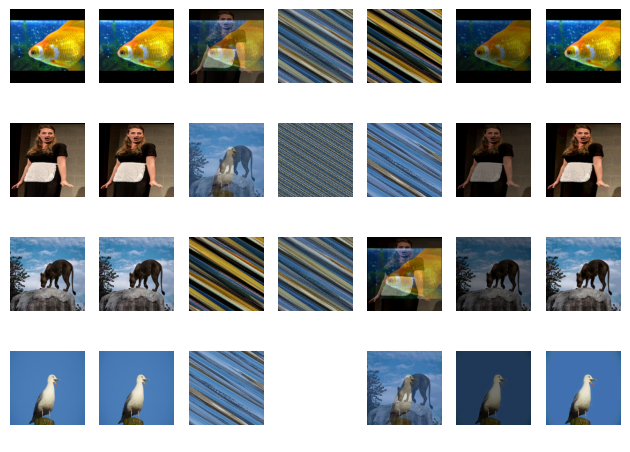

In [40]:
fig, axes = plt.subplots(4, 7)

plot_image(axes[0][0], img1)
plot_image(axes[1][0], img2)
plot_image(axes[2][0], img3)
plot_image(axes[3][0], img4)

plot_image(axes[0][1], scr_img_1)
plot_image(axes[1][1], scr_img_2)
plot_image(axes[2][1], scr_img_3)
plot_image(axes[3][1], scr_img_4)

plot_image(axes[0][2], combined_image_pixel_wise_1)
plot_image(axes[1][2], combined_image_pixel_wise_2)
plot_image(axes[2][2], scr_combined_image_pixel_wise_1)
plot_image(axes[3][2], scr_combined_image_pixel_wise_2)

plot_image(axes[0][3], combined_image_lsb)
plot_image(axes[1][3], scrambled_image)

plot_image(axes[2][3], descrambled_image)
# plot_image(axes[3][3], img4_NN_refined_pixel_wise)

plot_image(axes[0][4], img1_defused_lsb)
plot_image(axes[1][4], img2_defused_lsb)
plot_image(axes[2][4], des_img1_defused_lsb)
plot_image(axes[3][4], des_img2_defused_lsb)

plot_image(axes[0][5], img1_reconstructed_pixel_wise)
plot_image(axes[1][5], img2_reconstructed_pixel_wise)
plot_image(axes[2][5], img3_reconstructed_pixel_wise)
plot_image(axes[3][5], img4_reconstructed_pixel_wise)

plot_image(axes[0][6], img1_NN_refined_pixel_wise)
plot_image(axes[1][6], img2_NN_refined_pixel_wise)
plot_image(axes[2][6], img3_NN_refined_pixel_wise)
plot_image(axes[3][6], img4_NN_refined_pixel_wise)

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

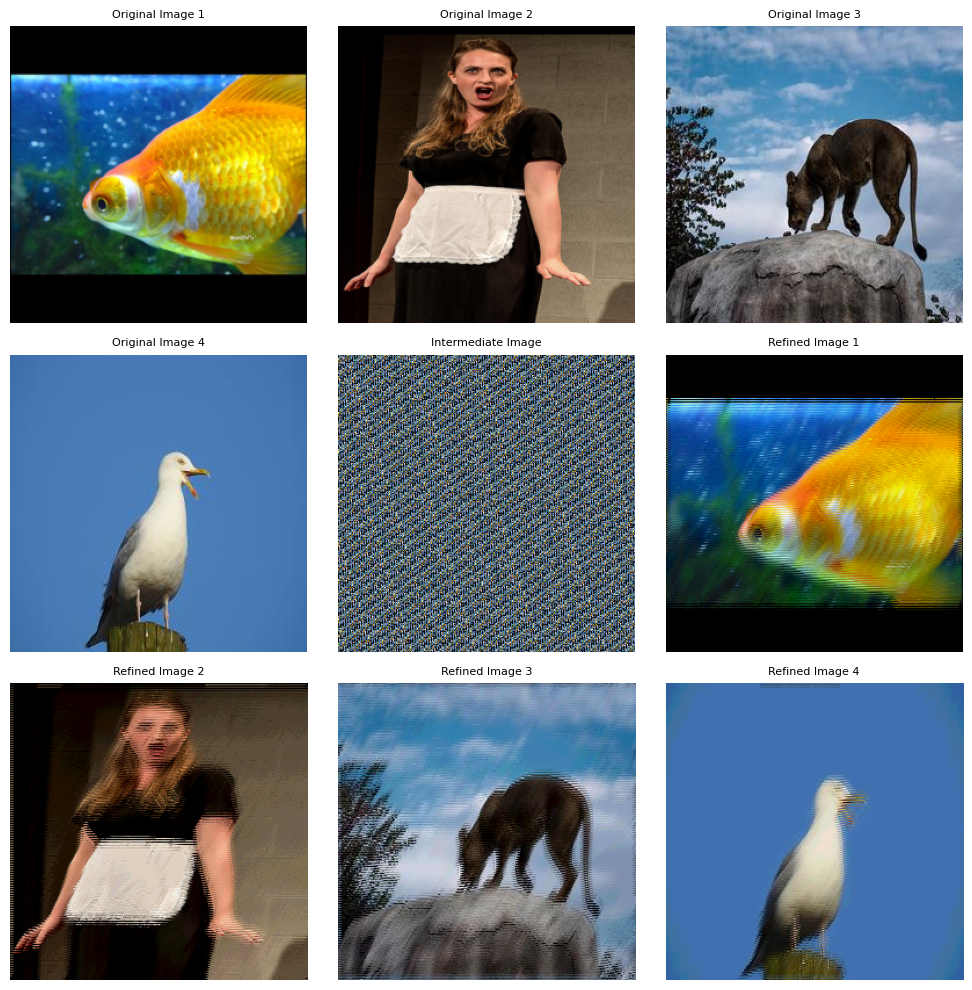

In [21]:
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], img3, "Original Image 3")
plot_image(axes[1][0], img4, "Original Image 4")
plot_image(axes[1][1], scrambled_image, "Intermediate Image")
# plot_image(axes[1][2], scrambled_image, "Intermediate Image")
plot_image(axes[1][2], rec1, "Refined Image 1")
plot_image(axes[2][0], rec2, "Refined Image 2")
plot_image(axes[2][1], rec3, "Refined Image 3")
plot_image(axes[2][2], rec4, "Refined Image 4")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

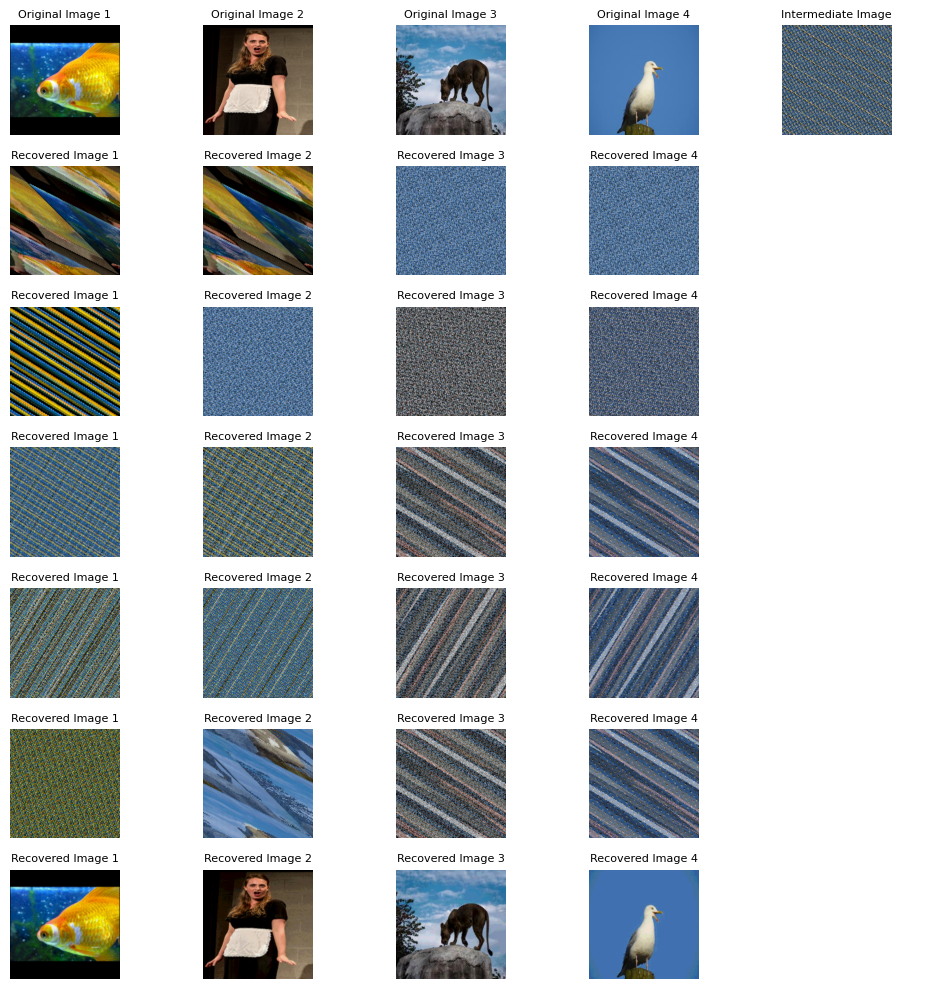

In [14]:
import time
encode_secret_key = '0000804'
decode_secret_key_1 = '0000784'
decode_secret_key_2 = '0000198'
decode_secret_key_3 = '0000028'
decode_secret_key_4 = '0000295'
decode_secret_key_5 = '0000182'
decode_secret_key_6 = '0000804'

image_path1 = './original_images/fuse1.JPEG'
image_path2 = './original_images/fuse2.JPEG'
image_path3 = './original_images/fuse3.JPEG'
image_path4 = './original_images/fuse4.JPEG'

img1, img2, img3, img4 = preprocess_images(image_path1, image_path2, image_path3, image_path4)

# ENCODE
def encode_images(img1, img2, img3, img4, encode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(encode_secret_key)
    scr_img_1 = arnold_transform_tensor(img1, sk1)
    scr_img_2 = arnold_transform_tensor(img2, sk2)
    scr_img_3 = arnold_transform_tensor(img3, sk3)
    scr_img_4 = arnold_transform_tensor(img4, sk4)
    combined_image_pixel_wise_1 = combine_images_pixel_wise(scr_img_1, scr_img_2)
    combined_image_pixel_wise_2 = combine_images_pixel_wise(scr_img_3, scr_img_4)
    scr_combined_image_pixel_wise_1 = arnold_transform_tensor(combined_image_pixel_wise_1, sk5)
    scr_combined_image_pixel_wise_2 = arnold_transform_tensor(combined_image_pixel_wise_2, sk6)
    combined_image_lsb = combine_images_pixel_wise_msb((scr_combined_image_pixel_wise_1*255).to(torch.uint8),(scr_combined_image_pixel_wise_2*255).to(torch.uint8))
    scrambled_image = arnold_transform_tensor(combined_image_lsb,sk7)
    return scrambled_image

# DECODE
def decode_images(scrambled_image, decode_secret_key):
    sk1, sk2, sk3, sk4, sk5, sk6, sk7 = seperate_key(decode_secret_key)
    descrambled_image = reverse_arnold_transform_tensor(scrambled_image,sk7)
    img1_defused_lsb, img2_defused_lsb = reconstruct_images_pixel_wise_msb(descrambled_image)
    img1_defused_lsb = img1_defused_lsb.to(torch.float32) / 255.0
    img2_defused_lsb = img2_defused_lsb.to(torch.float32) / 255.0
    des_img1_defused_lsb = reverse_arnold_transform_tensor(img1_defused_lsb,sk5)
    des_img2_defused_lsb = reverse_arnold_transform_tensor(img2_defused_lsb,sk6)
    img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img1_defused_lsb)
    # img1_reconstructed_pixel_wise = img1_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img2_reconstructed_pixel_wise = img2_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
    img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
    des_img1_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img1_NN_refined_pixel_wise,sk1)
    des_img2_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img2_NN_refined_pixel_wise,sk2)
    img3_reconstructed_pixel_wise, img4_reconstructed_pixel_wise = reconstruct_images_pixel_wise(des_img2_defused_lsb)
    # img3_reconstructed_pixel_wise = img3_reconstructed_pixel_wise.to(torch.float32) / 255.0
    # img4_reconstructed_pixel_wise = img4_reconstructed_pixel_wise.to(torch.float32) / 255.0
    img3_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img3_reconstructed_pixel_wise, 1)
    img4_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img4_reconstructed_pixel_wise, 2)
    des_img3_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img3_NN_refined_pixel_wise,sk3)
    des_img4_reconstructed_pixel_wise = reverse_arnold_transform_tensor(img4_NN_refined_pixel_wise,sk4)
    return des_img1_reconstructed_pixel_wise, des_img2_reconstructed_pixel_wise, des_img3_reconstructed_pixel_wise, des_img4_reconstructed_pixel_wise 


scrambled_image = encode_images(img1, img2, img3, img4, encode_secret_key)
rec_1_1, rec_1_2, rec_1_3, rec_1_4 = decode_images(scrambled_image, decode_secret_key_1)
rec_2_1, rec_2_2, rec_2_3, rec_2_4 = decode_images(scrambled_image, decode_secret_key_2)
rec_3_1, rec_3_2, rec_3_3, rec_3_4 = decode_images(scrambled_image, decode_secret_key_3)
rec_4_1, rec_4_2, rec_4_3, rec_4_4 = decode_images(scrambled_image, decode_secret_key_4)
rec_5_1, rec_5_2, rec_5_3, rec_5_4 = decode_images(scrambled_image, decode_secret_key_5)
rec_6_1, rec_6_2, rec_6_3, rec_6_4 = decode_images(scrambled_image, decode_secret_key_6)

fig, axes = plt.subplots(7, 5, figsize=(10, 10))

plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], img3, "Original Image 3")
plot_image(axes[0][3], img4, "Original Image 4")
plot_image(axes[0][4], scrambled_image, "Intermediate Image")

plot_image(axes[1][0], rec_1_1, "Recovered Image 1")
plot_image(axes[1][1], rec_1_2, "Recovered Image 2")
plot_image(axes[1][2], rec_1_3, "Recovered Image 3")
plot_image(axes[1][3], rec_1_4, "Recovered Image 4")

plot_image(axes[2][0], rec_2_1, "Recovered Image 1")
plot_image(axes[2][1], rec_2_2, "Recovered Image 2")
plot_image(axes[2][2], rec_2_3, "Recovered Image 3")
plot_image(axes[2][3], rec_2_4, "Recovered Image 4")

plot_image(axes[3][0], rec_3_1, "Recovered Image 1")
plot_image(axes[3][1], rec_3_2, "Recovered Image 2")
plot_image(axes[3][2], rec_3_3, "Recovered Image 3")
plot_image(axes[3][3], rec_3_4, "Recovered Image 4")

plot_image(axes[4][0], rec_4_1, "Recovered Image 1")
plot_image(axes[4][1], rec_4_2, "Recovered Image 2")
plot_image(axes[4][2], rec_4_3, "Recovered Image 3")
plot_image(axes[4][3], rec_4_4, "Recovered Image 4")

plot_image(axes[5][0], rec_5_1, "Recovered Image 1")
plot_image(axes[5][1], rec_5_2, "Recovered Image 2")
plot_image(axes[5][2], rec_5_3, "Recovered Image 3")
plot_image(axes[5][3], rec_5_4, "Recovered Image 4")

plot_image(axes[6][0], rec_6_1, "Recovered Image 1")
plot_image(axes[6][1], rec_6_2, "Recovered Image 2")
plot_image(axes[6][2], rec_6_3, "Recovered Image 3")
plot_image(axes[6][3], rec_6_4, "Recovered Image 4")

# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

In [15]:
def arnold_transform_tensor_with_key(image_tensor: torch.Tensor, iterations: int = 1, key: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  # Assuming image is square (N x N)
    transformed_image = image_tensor.clone()
    
    # Use the key to generate some variation in the transform (e.g., offset the transformations)
    key = key % N  # Ensure the key is within the size bounds
    
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                # Modify the Arnold transform equations using the key
                x_new = (x + y + key) % N
                y_new = (x + 2 * y + key) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image
    
    return transformed_image


def reverse_arnold_transform_tensor_with_key(image_tensor: torch.Tensor, iterations: int = 1, key: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  # Assuming image is square (N x N)
    transformed_image = image_tensor.clone()
    
    # Use the key to generate some variation in the reverse transform
    key = key % N  # Ensure the key is within the size bounds
    
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                # Modify the reverse Arnold transform equations using the key
                x_new = (2 * x - y + key) % N
                y_new = (-x + y + key) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image
    
    return transformed_image


# scrambled_image_1 = arnold_transform_tensor_with_key(img1, 8, 8)
# restored_image_1 = reverse_arnold_transform_tensor_with_key(scrambled_image_1, 8, 8)

# fig, axes = plt.subplots(1, 3, figsize=(10, 10))
# plot_image(axes[0], img1, "Original Image")
# plot_image(axes[1], scrambled_image_1, "Scrambled Image")
# plot_image(axes[2], restored_image_1, "Restored Image")

# plt.tight_layout()
# plt.show()

In [2]:
def string_to_7_digit_number(text, key_length=3):
    if key_length == 7:
        return abs(hash(text)) % 10_000_000 
    elif key_length == 3:
        return abs(hash(text)) % 1_000
    else:
        print("Key Length shoulb be 3 or 7")
        exit()

print(string_to_7_digit_number("a", 3))  
print(string_to_7_digit_number("a", 7))  

705
5381705
